link archivos: https://drive.google.com/drive/folders/18zO1OYeYHEbi897Ote2zSyN3lOCGhNAS

In [1]:
import pandas as pd
import numpy as np
import pandas as pd
from sklearn.preprocessing import LabelEncoder
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

In [2]:
df=pd.read_csv("df_graficas.csv")

In [3]:
df = df.assign(edad_=0)
df['edad_'] = pd.cut(df['Edad Cliente'], bins=[0, 20, 30, 40, 50, 60, np.inf], labels=[0, 1, 2, 3, 4, 5])

In [4]:
df = df.assign(pais_=0)
df['pais_'] = df['Ope Pais'].apply(lambda x: 'mx' if x==47 else 'us' if x==70 else 'other')

In [5]:
df['Giro Nombre'] = df['Giro Nombre'].astype(str)

encoded_columns = pd.get_dummies(df[['edad_', 'pais_','Giro Nombre']])
# Agregar las nuevas columnas codificadas en el mismo DataFrame
df_2 = pd.concat([df, encoded_columns], axis=1)

,Id Cliente,Sexo Cliente,Edad Cliente,Estado Cliente,Ope Pais,Giro Nombre,Mcc Nombre,noviembre,diciembre,enero,...,Giro Nombre_25,Giro Nombre_26,Giro Nombre_27,Giro Nombre_3,Giro Nombre_4,Giro Nombre_5,Giro Nombre_6,Giro Nombre_7,Giro Nombre_8,Giro Nombre_9
0,1,0,38,29,47,17,239,20.18,20.18,20.18,...,0,0,0,0,0,0,0,0,0,0
1,1,0,38,29,47,25,237,158.15,158.15,158.15,...,1,0,0,0,0,0,0,0,0,0
2,1,0,38,29,47,17,167,59.85,59.85,59.85,...,0,0,0,0,0,0,0,0,0,0
3,1,0,38,29,47,16,0,167.61,167.61,167.61,...,0,0,0,0,0,0,0,0,0,0
4,2,0,28,11,47,25,237,74.32,74.32,74.32,...,1,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97751,9999,1,29,29,47,9,97,109.75,109.75,109.75,...,0,0,0,0,0,0,0,0,0,1
97752,9999,1,29,29,47,24,40,135.70,135.70,135.70,...,0,0,0,0,0,0,0,0,0,0
97753,10000,1,14,22,47,17,239,20.93,20.93,20.93,...,0,0,0,0,0,0,0,0,0,0
97754,10000,1,14,22,70,17,223,102.53,102.53,102.53,...,0,0,0,0,0,0,0,0,0,0


In [6]:
df = df_2.reindex(columns=['Id Cliente', 'Sexo Cliente', 'Edad Cliente', 'Mcc Nombre', 'edad__0', 'edad__1',
       'edad__2', 'edad__3', 'edad__4', 'edad__5', 'pais__mx', 'pais__other',
       'pais__us', 'Giro Nombre_0', 'Giro Nombre_1', 'Giro Nombre_10',
       'Giro Nombre_11', 'Giro Nombre_12', 'Giro Nombre_13', 'Giro Nombre_14',
       'Giro Nombre_15', 'Giro Nombre_16', 'Giro Nombre_17', 'Giro Nombre_18',
       'Giro Nombre_19', 'Giro Nombre_2', 'Giro Nombre_20', 'Giro Nombre_21',
       'Giro Nombre_22', 'Giro Nombre_23', 'Giro Nombre_24', 'Giro Nombre_25',
       'Giro Nombre_26', 'Giro Nombre_27', 'Giro Nombre_3', 'Giro Nombre_4',
       'Giro Nombre_5', 'Giro Nombre_6', 'Giro Nombre_7', 'Giro Nombre_8',
       'Giro Nombre_9','noviembre', 'diciembre',
       'enero', 'febrero', 'marzo'])
df.to_csv('df_encoding.csv', index=False)


In [7]:
n=df.shape[1]
m=df.shape[0]

X = df.iloc[:, 4:n-1]
y = df.iloc[:, n-1]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
reg = LinearRegression()
reg.fit(X_train, y_train)
y_pred = reg.predict(X_test)

print('R cuadrado:', r2_score(y_test, y_pred))
print('MAE:', mean_absolute_error(y_test, y_pred))
print('MSE:', mean_squared_error(y_test, y_pred))

R cuadrado: 0.9570168753127353
MAE: 11.563991310035338
MSE: 1975.0557241276967


In [10]:
prediccion.to_csv('prediccion_abril.csv', index=False)


In [11]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split

predicciones2 = pd.DataFrame(0, index=range(m), columns=['Prediccion_abril'])
rf = RandomForestRegressor(n_estimators=100, random_state=42)
rf.fit(X_train, y_train)

for k in range(m):
    
    a = df.iloc[k, 4:41].values
    b = df.iloc[k, -(n-42):].values
    c = np.concatenate((a, b))
    predicciones2.iloc[k,0]=rf.predict([c])

prediccion2= pd.concat([df, predicciones2], axis=1)

/Users/kevingonzalez/anaconda3/envs/bloqueCienciaDatos/lib/python3.10/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/Users/kevingonzalez/anaconda3/envs/bloqueCienciaDatos/lib/python3.10/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/Users/kevingonzalez/anaconda3/envs/bloqueCienciaDatos/lib/python3.10/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/Users/kevingonzalez/anaconda3/envs/bloqueCienciaDatos/lib/python3.10/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(
/Users/kevingonzalez/anaconda3/envs/bloqueCienciaDatos/lib/python3.10/site-packages/skle

Ingresa el ID del cliente deseado: 4


/var/folders/hr/mdc9cyj17cq_dknl0gp46ndh0000gn/T/ipykernel_88965/1444891637.py:68: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax2.set_xticklabels(df_sorted['Mcc Nombre'], rotation=90, fontsize=9)
/var/folders/hr/mdc9cyj17cq_dknl0gp46ndh0000gn/T/ipykernel_88965/1444891637.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tabla.sort_values('Total', ascending=False, inplace=True)


,id_cliente,nombre_comercio,giro_nombre,mcc_nombre,December,February,January,March,November,Total
19,4,OPENPAY*TRANSPAIS UNICVICTORIA TAM,AGREGADOR,AGREGADOR,616.72,322.33,765.92,0.0,0.00,1704.97
17,4,MERCADO PAGO 3 CIUDAD DE MEX001,OTROS,MERCADO DIRECTO - VENTAS POR CATALOGO,475.98,0.00,0.00,0.0,0.00,475.98
20,4,ZAP ITALICA CD VICTORIA T028,RETAIL,ZAPATERIAS,0.00,0.00,199.07,0.0,0.00,199.07
15,4,CFE CONTIGO MU MEXICO DF DF,GOBIERNO,"SERV GUBERNAM, AGUA, ELECTRICIDAD,PREDIAL,TENE...",0.00,0.00,117.24,0.0,0.00,117.24
16,4,CONEKTA*OXXOSPIN CIUDAD DE MEX001,OTROS,SERVICIOS RELACIONES PUBLICAS (SERVICIOS CONSU...,0.00,0.00,0.00,0.0,11.79,11.79
18,4,OPENPAY*TRANSPAIS SAN VICTORIA TAM,AGREGADOR,AGREGADOR,0.00,10.45,0.00,0.0,0.00,10.45


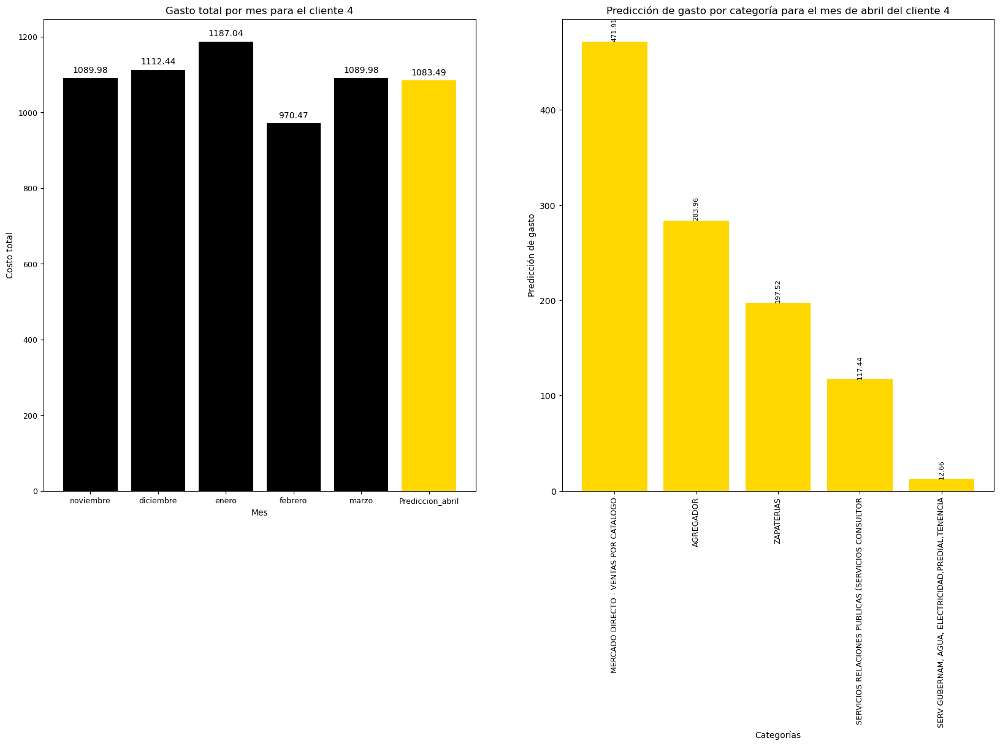

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

In [19]:
import matplotlib.pyplot as plt

df_lleno = pd.read_csv('df_lleno.csv')
data = pd.read_csv('prediccion_abril.csv')

mcc = df_lleno['Mcc Nombre']
data = data.drop('Mcc Nombre', axis=1)

df_wpred = pd.concat([data, mcc], axis=1)
# Cargar los datos en un DataFrame de Pandas
data = pd.read_csv('prediccion_abril.csv')

# Obtener el ID del cliente deseado como input del usuario
id_cliente = input("Ingresa el ID del cliente deseado: ")

# Verificar si el ID del cliente existe en el DataFrame
if int(id_cliente) not in data['Id Cliente'].values:
    print(f"El ID del cliente {id_cliente} no se encuentra en el DataFrame")
else:
    # Filtrar los datos para obtener solo las filas correspondientes al ID del cliente deseado
    cliente_data = data[data['Id Cliente'] == int(id_cliente)]

    # Obtener la columna que contiene el nombre del Mcc
    giro_n9 = cliente_data.columns.get_loc('Giro Nombre_9')

    # Obtener el número de columnas a partir de la columna del Mcc
    cantidad_meses = len(cliente_data.columns[giro_n9 + 1:])

    # Crear el diccionario de costos por mes
    meses = cliente_data.columns[giro_n9+1:]
    colors = ['black']*(len(meses)-1) + ['gold']
    costos_por_mes = {}
    for i, mes in enumerate(meses):
        costos_por_mes[mes] = cliente_data[mes].sum()

    # Crear la gráfica de barras para el primer subplot
    fig, axs = plt.subplots(1, 2, figsize=(20, 10))
    ax1 = axs[0]
    ax1.bar(list(costos_por_mes.keys()), list(costos_por_mes.values()), color=colors)
    ax1.set_title(f'Gasto total por mes para el cliente {id_cliente}')
    ax1.set_xlabel('Mes')
    ax1.set_ylabel('Costo total')
    ax1.tick_params(labelsize=9)
    
    # Agregar leyenda con el valor del costo total en cada barra
    for i, costo in enumerate(costos_por_mes.values()):
        ax1.text(i, costo+10, f'{costo:.2f}', ha='center', va='bottom', fontsize=10)

    # Filtrar los datos para obtener solo las filas correspondientes al ID del cliente deseado
    cliente_data = df_wpred[df_wpred['Id Cliente'] == int(id_cliente)]

    df_sorted = cliente_data.sort_values(by='Prediccion_abril', ascending=False)

    # Redondear la columna 'Prediccion_abril' a 2 decimales
    df_sorted['Prediccion_abril'] = df_sorted['Prediccion_abril'].round(2)

    # Crear la gráfica de barras para el segundo subplot
    ax2 = axs[1]
    ax2.bar(df_sorted['Mcc Nombre'], df_sorted['Prediccion_abril'], color='gold')
    ax2.set_xlabel('Categorías')
    ax2.set_ylabel('Predicción de gasto')
    ax2.set_title(f'Predicción de gasto por categoría para el mes de abril del cliente {id_cliente}')

    
    # Agregar la etiqueta de valor redondeado a cada barra
    for i, val in enumerate(df_sorted['Prediccion_abril']):
        ax2.text(i, val, f"{val}", horizontalalignment='center', verticalalignment='bottom', fontdict={'fontweight':500, 'size':8}, rotation=90)
        ax2.set_xticklabels(df_sorted['Mcc Nombre'], rotation=90, fontsize=9)

        plt.figure()

df_transacciones = pd.read_csv("df_transacciones.csv")
tabla=df_transacciones.loc[df_transacciones['id_cliente'] == int(id_cliente)]
tabla.sort_values('Total', ascending=False, inplace=True)
tabla